In [1]:
from utils import *
from models import *
import os

c:\Users\ry2460\anaconda3\envs\timeseries_forecasting\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


GPU available: True


In [2]:
data_folder = "./data"
results_folder = "./results"
figures_folder = "./figures"

num_samples = 1000
forecast_horizons = [2,4,8,16]
alpha_vals = [0.02, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5 ,0.6, 0.7, 0.8, 0.9, 1]

In [3]:
data_type = "diarrhea" #"malaria" #
data_fname = "{}/mozambique_{}_cases_by_province.csv".format(data_folder,data_type)
df_cases = read_provinces_timeseries_data(data_fname)

data_demo_fname = "{}/mozambique_demographics_by_province.csv".format(data_folder)
df_demo = read_provinces_timeseries_data(data_demo_fname)

coverage_fname = "{}/weekly_coverage_per_province.csv".format(data_folder)
df_coverage = read_provinces_timeseries_data(coverage_fname)

df_rates = 1e5*df_cases/(df_demo*df_coverage)
provinces = df_rates.columns.values

plot_data_time_series = False
if(plot_data_time_series):
    plot_provinces_timeseries_data(df_cases,provinces,'cases')
    plot_provinces_timeseries_data(df_demo,provinces,'pop. size')
    plot_provinces_timeseries_data(df_coverage,provinces,'coverage')
    plot_provinces_timeseries_data(df_rates,provinces,'rate per 100,000')


In [5]:
date = '230624'
backtests_results_dir = "{}/{}/backtests_{}".format(results_folder,date,data_type)
if not os.path.isdir(backtests_results_dir):
    os.makedirs(backtests_results_dir)

start_date = pd.Timestamp('2018-07-02') - pd.Timedelta(weeks=max(forecast_horizons))
end_date = df_rates.index[-1]
pred_dates = pd.DatetimeIndex(data=[start_date + pd.Timedelta(weeks=w) for w in range(int((end_date-start_date).days/7))])
len(pred_dates)

250

In [6]:
model_list_local, model_list_global = get_forecasting_models(data_type)
models = list(model_list_local.keys()) + list(model_list_global.keys()) 

In [7]:
for model_desc in model_list_local:
    print("-----------model={}-----------".format(model_desc))
    model = model_list_local[model_desc]
    run_backtests_local(df_rates, provinces, model, model_desc, forecast_horizons, 
                        pred_dates, num_samples, backtests_results_dir)
    
for model_desc in model_list_global:
    print("-----------model={}-----------".format(model_desc))
    model = model_list_global[model_desc]
    run_backtests_global(df_rates, provinces, model, model_desc, forecast_horizons, 
                        pred_dates, num_samples, backtests_results_dir)

-----------horizon=2-----------
-----------province=CABO DELGADO-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=GAZA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=INHAMBANE-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=MANICA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=MAPUTO CIDADE-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=MAPUTO PROVINCIA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=NAMPULA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=NIASSA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=SOFALA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=TETE-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=ZAMBEZIA-----------
ExponentialSmoothing
Ligh

C:\Users\ry2460\AppData\Local\Temp\ipykernel_30400\735637464.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(len(models)+2, 1,  figsize=(12, 25))


LightGBM_Global
NHiTS_Global
-----------province=ZAMBEZIA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------horizon=8-----------
-----------province=CABO DELGADO-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=GAZA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=INHAMBANE-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=MANICA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=MAPUTO CIDADE-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=MAPUTO PROVINCIA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=NAMPULA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=NIASSA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=SOFALA-----------
ExponentialSmoothing
LightGBM_Global
NHiTS_Global
-----------province=TETE--------

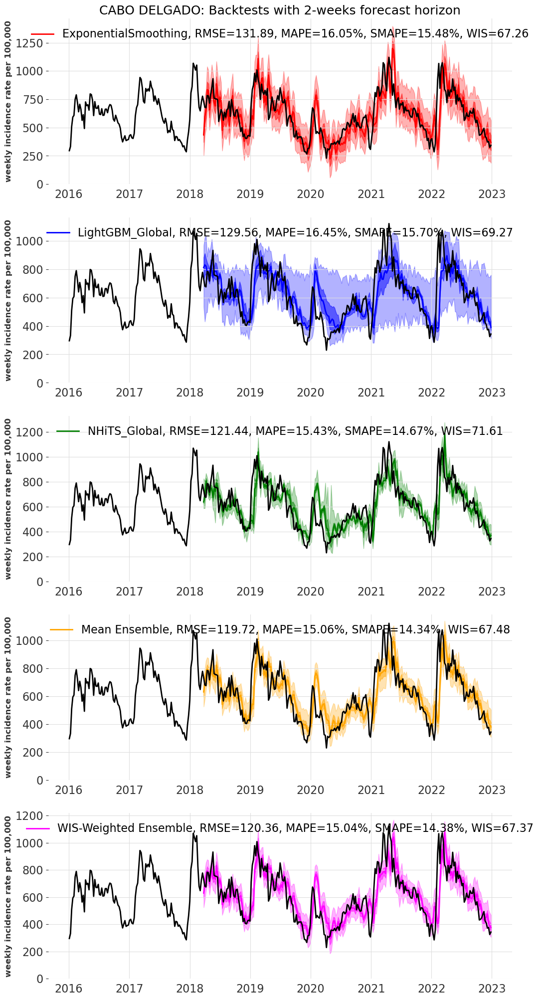

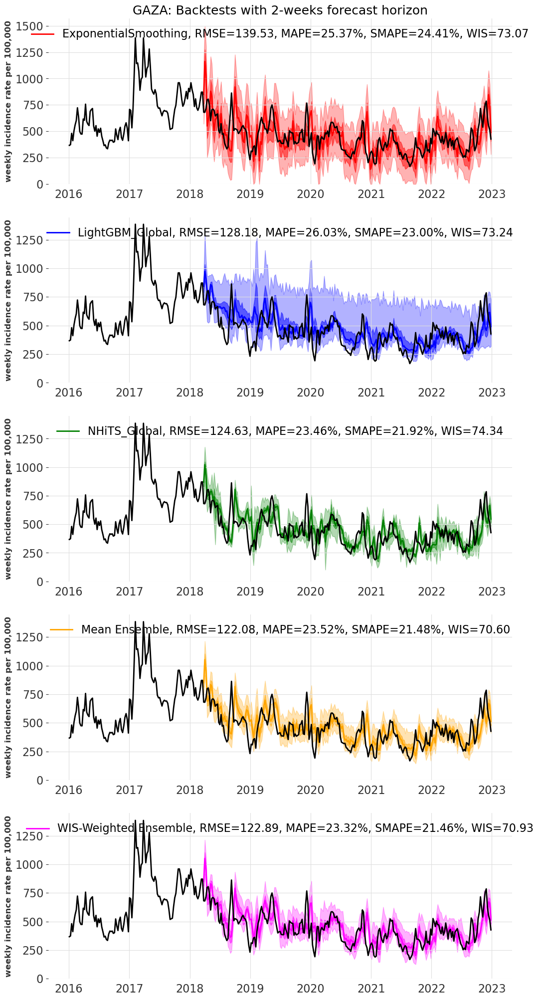

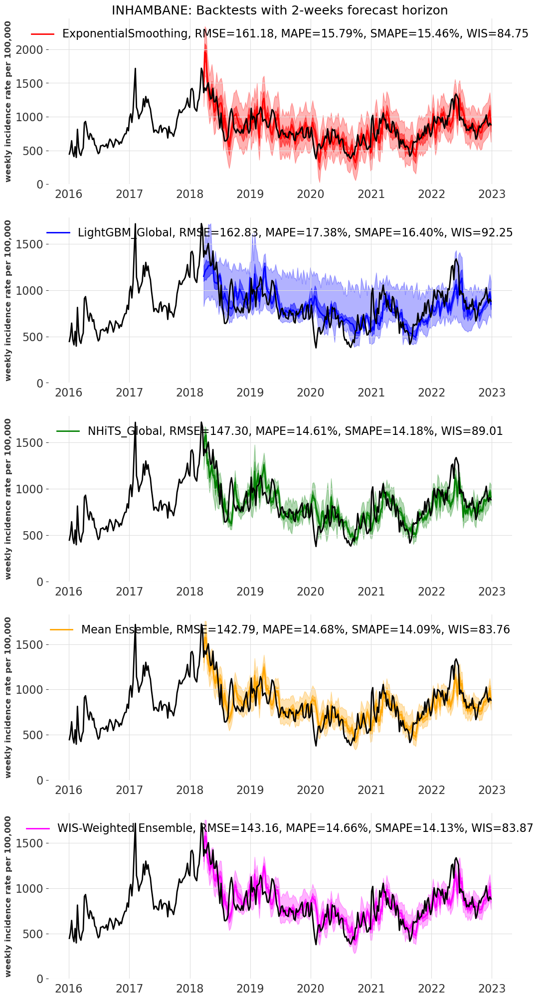

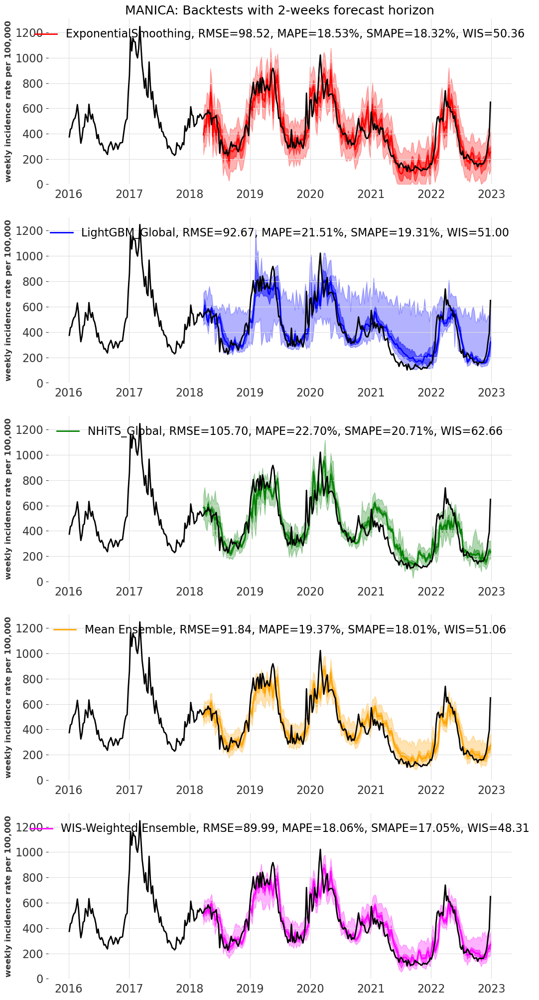

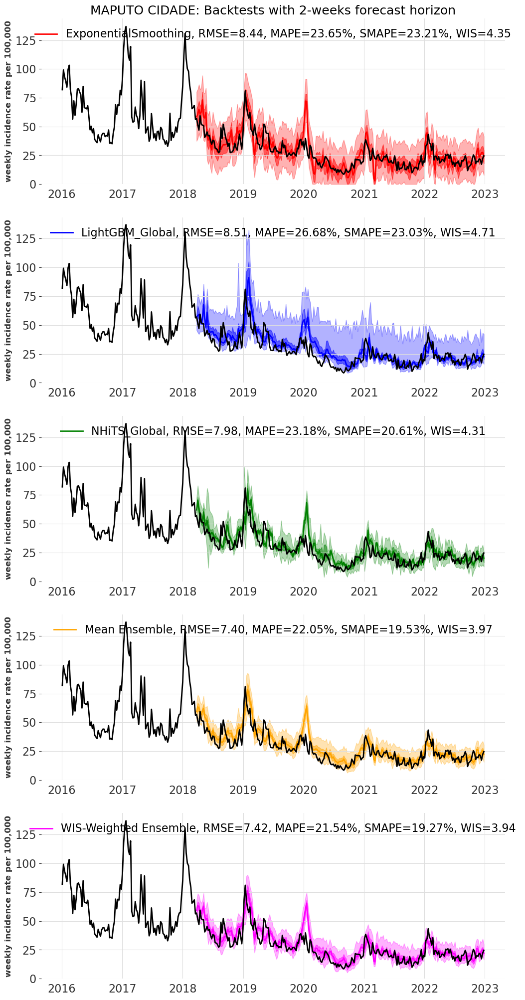

...

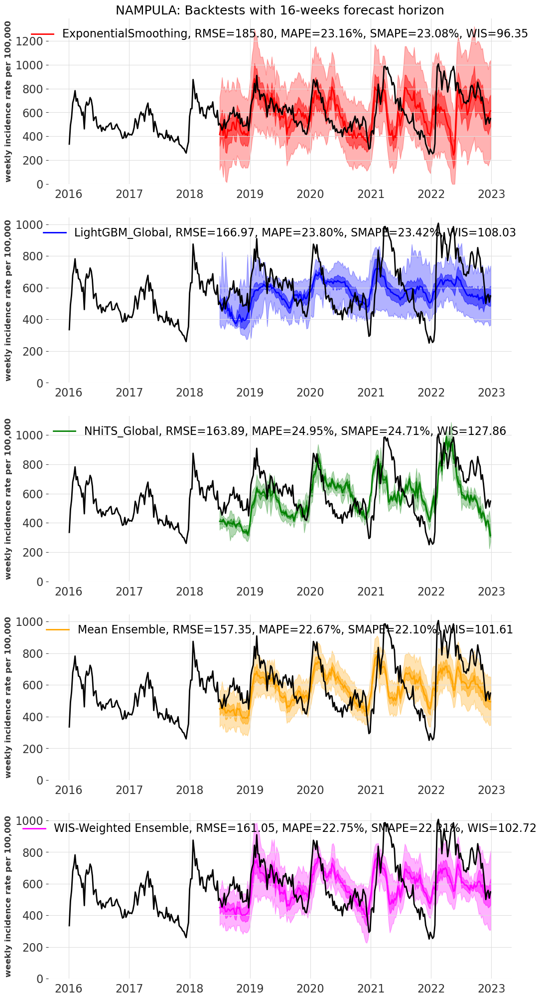

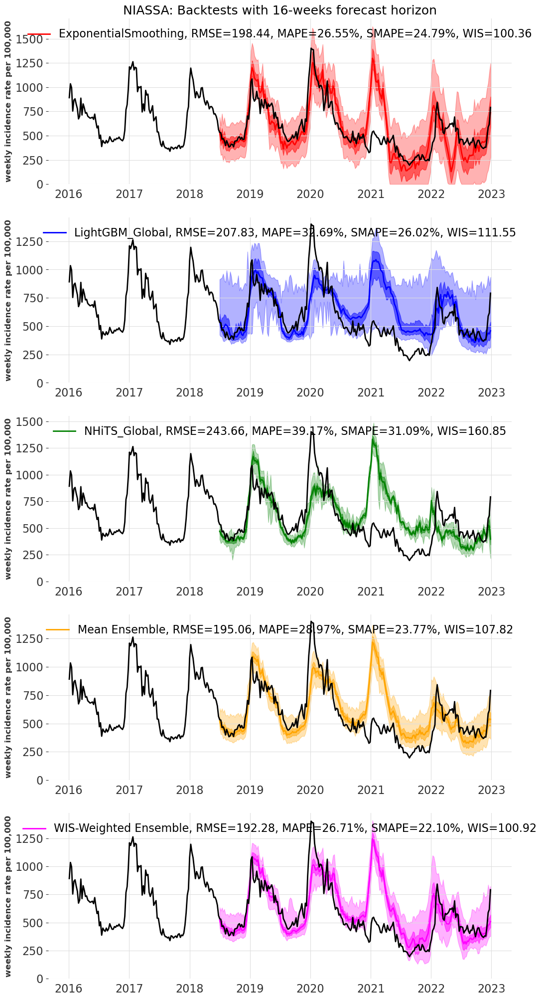

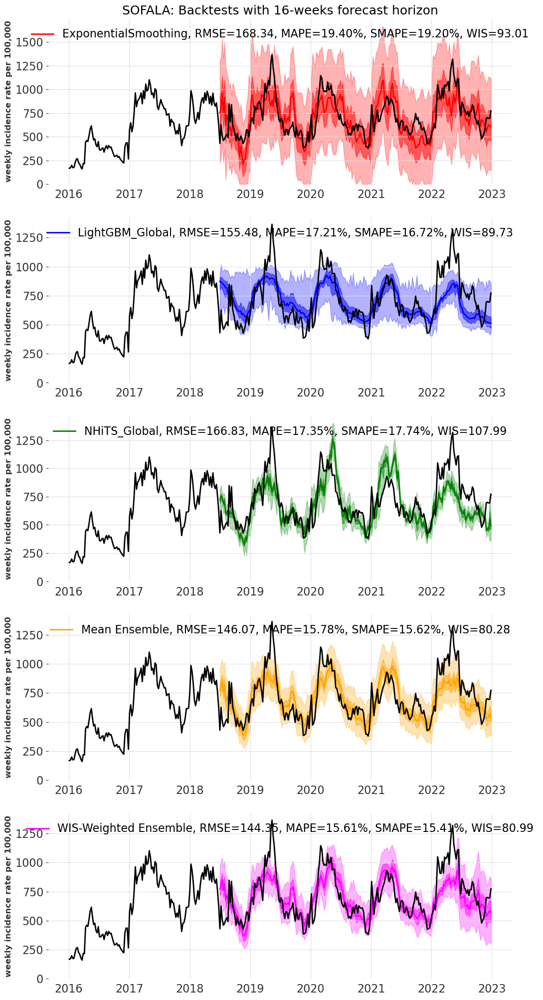

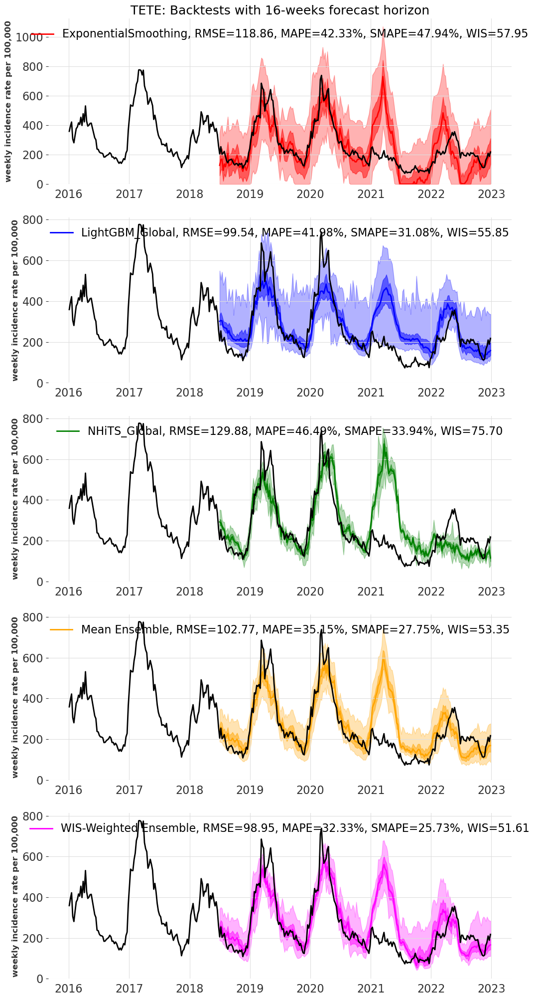

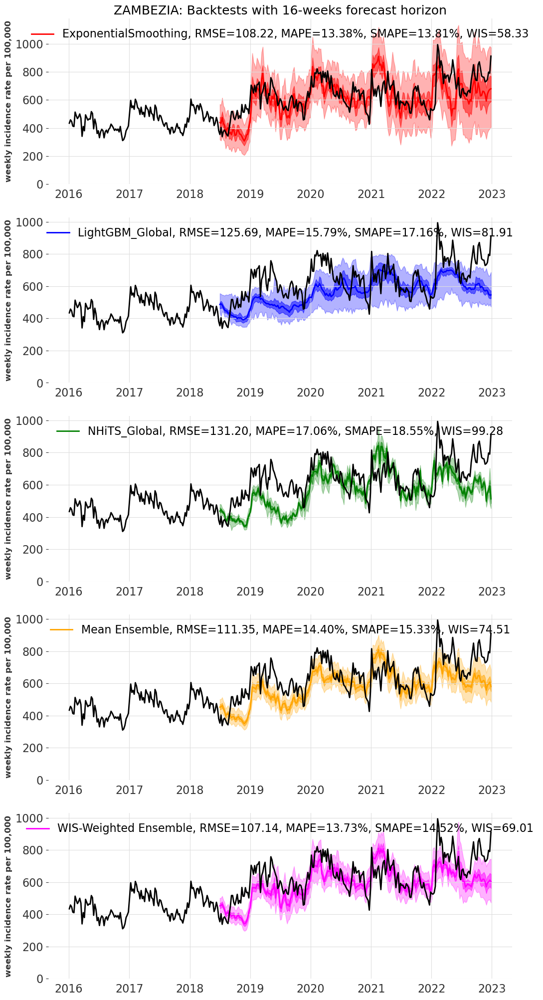

In [8]:
#load results and generate ensembles

file_list = os.listdir(backtests_results_dir)
pred_results = {}
for _, file in enumerate(file_list):
    with open(backtests_results_dir+'/'+file, 'rb') as f:
        pred_dict = pickle.load(f)
    pred_results.update(pred_dict)

colors = ['red', 'blue', 'green', 'orange', 'magenta']

seasons = {
'2019' : [pd.Timestamp('2019-01-01'),pd.Timestamp('2019-12-31')],
'2020' : [pd.Timestamp('2020-01-01'),pd.Timestamp('2020-12-31')],
'2021' : [pd.Timestamp('2021-01-01'),pd.Timestamp('2021-12-31')],
'2022' : [pd.Timestamp('2022-01-01'),pd.Timestamp('2022-12-31')],
}
                              
df_metrics = pd.DataFrame(columns=['province','model','horizon','season','metric','value'])

plot_figures = True
generate_mean_ensemble = True
generate_wis_ensemble = True

for horizon in forecast_horizons:

    print("-----------horizon={}-----------".format(horizon))

    figures_output_dir = "{}/{}/{}/pred_weeks_horizon_{}".format(figures_folder,date,data_type,horizon)
    if not os.path.isdir(figures_output_dir):
        os.makedirs(figures_output_dir)

    for province in provinces:
        print("-----------province={}-----------".format(province))
        series = get_province_timeseries(df_rates, province)

        df_wis = pd.DataFrame(index=series.time_index,columns=models)
        pred_list = []
        
        if(plot_figures):
            fig, axes = plt.subplots(len(models)+2, 1,  figsize=(12, 25)) 

        for i, model in enumerate(models):
            key = province + "_" +model +"_" + str(horizon)
            if key in pred_results.keys():
                pred = pred_results[key]
                pred = pred[pred.time_index[pred.time_index<=max(series.time_index)]]
                pred_list.append(pred)
                ax = axes[i] if plot_figures else None
                color = colors[i] if plot_figures else None
                print(model)
                df_metrics, wis_vals = calculate_and_plot_pred_fit(pred, series, province, model, horizon, df_metrics, alpha_vals, seasons, ax, color)
                df_wis.loc[pred.time_index,model] = wis_vals

        if(generate_mean_ensemble):
            model = 'Mean Ensemble'
            pred_mean = pred_list[0]
            for j in range(1,len(pred_list)):
                pred_new = pred_list[j]
                pred_mean = pred_mean.slice_intersect(pred_new)
                pred_new = pred_new.slice_intersect(pred_mean)
                pred_mean = pred_mean + pred_new
            pred_mean = pred_mean/len(pred_list)
            pred_mean = pred_mean[pred_mean.time_index[pred_mean.time_index<=max(series.time_index)]]
            pred_results[province + "_" +model +"_" + str(horizon)] = pred_mean
            i = i+1
            ax = axes[i] if plot_figures else None
            color = colors[i] if plot_figures else None
            df_metrics, wis_vals = calculate_and_plot_pred_fit(pred_mean, series, province, model, horizon, df_metrics, alpha_vals, seasons, ax, color)

        if(generate_wis_ensemble):
            model = 'WIS-Weighted Ensemble'
            wis_weights_win = 4
            df_weights = []
            pred_wgt_mean = pred_mean
            time = pred_wgt_mean.time_index
            df_wis = df_wis.loc[time,:]
            # df_wis = df_wis.fillna(1000)
            df_wis = df_wis.apply(lambda col : np.cumsum(col), axis = 0)
            df_wis = df_wis.apply(lambda col : col-col.shift(wis_weights_win), axis = 0)
            df_wis = df_wis.apply(lambda row : 1/row, axis = 1)
            df_wis = df_wis.apply(lambda row : row/sum(row), axis = 1)
            pred_wgt_mean = pred_wgt_mean[time[0:(wis_weights_win+horizon)]]
            for t in time[(wis_weights_win+horizon):len(time)]:
                df_wis_t = df_wis[(df_wis.index==t-pd.Timedelta(weeks=horizon))]
                w_df   = pd.DataFrame(columns=["weight", "model_name"])
                w_df["weight"] = df_wis_t.iloc[0,:].values
                df_weights.append(w_df.weight.values.tolist())
                pred_wgt_mean = pred_wgt_mean.append(sum([pred_list[i][t]*w_df.iloc[i].values[0] for i in range(0,len(pred_list))]))

            pred_wgt_mean = pred_wgt_mean[pred_mean.time_index[pred_mean.time_index<=max(series.time_index)]]
            pred_results[province + "_" +model +"_" + str(horizon)] = pred_wgt_mean
            i = i+1
            ax = axes[i] if plot_figures else None
            color = colors[i] if plot_figures else None
            df_metrics, wis_vals = calculate_and_plot_pred_fit(pred_wgt_mean, series, province, model, horizon, df_metrics, alpha_vals, seasons, ax, color)

        if(plot_figures):
            axes[0].set_title('{}: Backtests with {}-weeks forecast horizon'.format(province,horizon),fontsize=18)
            plt.savefig(figures_output_dir +"/" + province + ".png", format="png", bbox_inches="tight", dpi=100)

results_output_dir = "{}/{}".format(results_folder, date, data_type)
results_fname = "{}/pred_results_{}_all_models.pkl".format(results_output_dir, data_type)
with open(results_fname, 'wb') as f:
   pickle.dump(pred_results, f)
df_metrics.to_csv("{}/metrics_{}.csv".format(results_output_dir, data_type), index=False) 

In [9]:
# results_dir = "{}/{}".format(results_folder, date)
# df_metrics = pd.read_csv("{}/metrics_{}.csv".format(results_dir, data_type)) 
# df_metrics = df_metrics.replace('rmse','RMSE')
# df_metrics = df_metrics.replace('mape','MAPE')
# df_metrics = df_metrics.replace('smape','SMAPE')
# df_metrics = df_metrics.replace('wis','WIS')
# df_metrics = df_metrics.replace('MAPUTO CIDADE','MAPUTO CITY')
# df_metrics = df_metrics.replace('MAPUTO PROVINCIA','MAPUTO')
# df_metrics = df_metrics[df_metrics.season=='2019']

# horizon = 4
# metric = 'WIS'
# subset_df = df_metrics[(df_metrics["horizon"]==horizon) & (df_metrics["metric"]==metric)]
# subset_df.groupby(['model'])['value'].mean()

# sns.set(style="whitegrid")
# metrics = df_metrics['metric'].unique()
# fig, axes = plt.subplots(nrows=len(metrics), ncols=1, figsize=(16, 4.5 * len(metrics)))
# for i, metric in enumerate(metrics):
#     ax = axes[i]
#     subset_df = df_metrics[(df_metrics['metric'] == metric)]
#     sns.boxplot(x='horizon', y='value', hue='model', data=subset_df, ax=ax, fliersize=3, palette="Set1")
#     ax.set_ylabel(metric, fontsize=18)
#     ax.tick_params(labelsize=16)
#     ax.set_xlabel('')
#     ax.legend([])
   
# axes[0].set_title(data_type,fontsize=20)
# axes[len(metrics)-1].set_xlabel('horizon (weeks)', fontsize=18)
# # axes[len(metrics)-1].legend(bbox_to_anchor=(-0.4, -0.25), loc='upper left', borderaxespad=0, title='model', fontsize=16)
# axes[len(metrics)-1].legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title='model', fontsize=16)
# #plt.tight_layout()
# plt.show()